In [147]:
#common
import pandas as pd
import numpy as np
import scipy.stats as stats 

#plotly
import plotly.express as px
import plotly.graph_objs as go
from plotly import tools
import plotly.offline  as py
py.init_notebook_mode(connected=True)

### Легенда

Мы провели А/Б тест на выдаче ресторанов (главный экран приложения) и стали подсовывать пользователям более дорогие и «выгодные» рестораны.

Пользователей поделили поровну 50-50 (по 10,000,000 пользователей в каждой группе за месяц):

- (test_group = A) – это контрольная группа, где пользователи видят главную страницу без изменений
- (test_group = В) – это тестовая группа, где пользователи видят более дорогие рестораны с высоким средним чеком и комиссией

Данные находятся в csv файле.


Структура данных - Orders:

- Order_id – айди заказа
- Test_group – тестовая группа
- Restaurant_id – айди сети ресторанов (Шоколадница/КФС/и тд)
- GMV – чек заказа (gross merchandise volume)


Структура данных - Restaurants:

- Restaurant_id – айди сети ресторанов (Шоколадница/КФС/и тд)
- Dc_commission – коммиссия ДС конкретной ресторанной сети(тот процент, что мы берем себе с заказов данной сети/ресторана).

Тебе нужно:

1. Выбрать метрики для твоего эксперимента
2. Подсчитать статистическую значимость
3. Интерпретировать результаты
4. Предоставить выводы и рекомендации

Любая дополнительная информация будет плюсом и любые дополнительные раскопки приветствуются.

### Решение

#### Посмотрим сначала на данные

In [461]:
orders_df = pd.read_csv('orders.csv', sep=';')
rest_df = pd.read_csv('restaurants.csv', sep=';').iloc[:, 1:]

In [462]:
orders_df.head()

,order_id,test_group,restaurant_id,gmv
0,286026417,B,6472,2838.0
1,281713374,A,6472,4235.0
2,280335864,A,6472,12001.0
3,301018110,A,10236,3025.0
4,300763509,A,10236,1600.5


In [463]:
# заказы у нас не дублируются, это хорошо
orders_df.agg(['nunique', 'count'])

,order_id,test_group,restaurant_id,gmv
nunique,698562,2,9408,4778
count,698562,698562,698562,698562


In [464]:
orders_df[['gmv']].describe().T

,count,mean,std,min,25%,50%,75%,max
gmv,698562.0,993.503624,855.901442,0.0,664.4,887.7,1155.0,447579.0


In [465]:
# id тоже не дублируются
rest_df.agg(['nunique', 'count'])

,id,dc_commission
nunique,10957,10688
count,10957,10957


#### Поженим заказы с комиссией

In [466]:
orders_df = orders_df.merge(rest_df, right_on='id', left_on='restaurant_id', how='left').drop(['id'], axis=1)

In [467]:
orders_df['commission'] = orders_df['gmv']*orders_df['dc_commission']/100

In [468]:
orders_df.head(3)

,order_id,test_group,restaurant_id,gmv,dc_commission,commission
0,286026417,B,6472,2838.0,32.377589,918.875978
1,281713374,A,6472,4235.0,32.377589,1371.190898
2,280335864,A,6472,12001.0,32.377589,3885.634467


In [469]:
orders_df[['commission']].describe().T

,count,mean,std,min,25%,50%,75%,max
commission,698562.0,344.313706,299.456932,0.0,228.78871,306.346725,402.880247,148234.096726


#### Посмотрим базовую аналитику

Для разных вариантов:
    
- кол-во заказов
- средний и медианный чек
- средняя и медианная комиссия

In [470]:
# user_id у нас нет, поэтому будем брать за основу order_id. Плюс он уникальный, поэтому можно все считать через count
orders_df_gr = orders_df.groupby('test_group').agg({'order_id':'count',
                                    'gmv':['mean', 'median'],
                                    'commission':['mean', 'median']})
orders_df_gr

order_id         gmv         commission            
              count        mean median        mean      median
test_group                                                    
A            351155  993.118095  887.7  344.235624  306.540682
B            347407  993.893314  886.6  344.392631  306.194308

Полученные значения очень похожи, в тестовой группе средняя комиссия чуть повыше, а медианная - даже ниже

### Метрики

In [471]:
orders_df.head(1)

,order_id,test_group,restaurant_id,gmv,dc_commission,commission
0,286026417,B,6472,2838.0,32.377589,918.875978


Возьмем в качестве основной метрики среднюю комиссию, потому что именно эти деньги мы в итоге зарабатываем и влиять нужно на них. 

Дополнительно посмотрим различия по среднему чеку. Возможно пользователи стали платить больше, но мы получаем меньше за счет того, что выросла доля ресторанов с низкой комиссией.

#### Посмотрим распределения

In [472]:
A_var = orders_df[orders_df.test_group=='A']['commission']
B_var = orders_df[orders_df.test_group=='B']['commission']

A_var_gmv = orders_df[orders_df.test_group=='A']['gmv']
B_var_gmv = orders_df[orders_df.test_group=='B']['gmv']

In [473]:
#px.histogram(orders_df[['test_group', 'commission']], color='test_group')

size=50
start = 0
end = 10000
trace1 = go.Histogram(
        x = list(A_var), 
        histnorm='probability', 
        xbins=dict(start=start, end=end, size=size),
        name='commission_A',
        #cumulative=dict(enabled=True), 
        opacity=0.7,
        visible=True
    )

trace2 = go.Histogram(
        x = list(B_var), 
        histnorm='probability',
        xbins=dict(start=start, end=end, size=size),
        #cumulative=dict(enabled=True), 
        name = 'commission_B',
        opacity=0.7,
        visible=True
    )

xaxis_params = dict(title='commission, rub',
                       showgrid=True)

layout = go.Layout(title='Распределение комиссии в вариантах', 
                       xaxis=go.layout.XAxis(**xaxis_params), 
                       yaxis=dict(title='freq',
                                 tickformat=',.0%',
                                 showgrid=True),
                      barmode='overlay')
fig = dict(data=[trace1,trace2], layout=layout)
py.iplot(fig)

Распределение даже похоже на нормальное, но с длинным хвостом справа

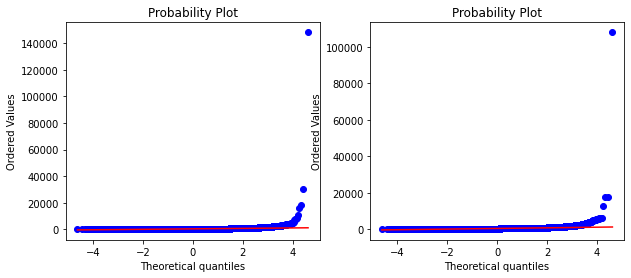

In [474]:
plt.figure(figsize=(10,4))
ax1 = plt.subplot(121)
stats.probplot(A_var, plot=plt)
ax2 = plt.subplot(122)
stats.probplot(B_var, plot=plt)
plt.show()

In [475]:
A_p_value = stats.shapiro(A_var)[1]
B_p_value = stats.shapiro(B_var)[1]
A_p_value, B_p_value

C:\Users\sharonova\AppData\Roaming\Python\Python37\site-packages\scipy\stats\morestats.py:1676: UserWarning:

p-value may not be accurate for N > 5000.



(0.0, 0.0)

In [476]:
stats.shapiro(A_var_gmv)[1],stats.shapiro(B_var_gmv)[1]

(0.0, 0.0)

Это значит, что обе выборки распределены нормально. Но я, пожалуй, все равно возьму критерий Манна-Уитни из-за хвостов

In [477]:
mw_comm_stat, mw_comm_p = stats.mannwhitneyu(A_var, B_var, True,'two-sided')
mw_gmv_stat, mw_gmv_p = stats.mannwhitneyu(A_var_gmv, B_var_gmv, True,'two-sided')
mw_comm_p, mw_gmv_p

(0.48283775650760197, 0.8440752907706608)

Кажется, значимых различий у нас нет. Посчитаем еще разницу средних

In [478]:
avg_comm_default = np.average(A_var)
avg_comm_test = np.average(B_var)
comm_advantage_in_percent = round((avg_comm_test - avg_comm_default) / avg_comm_default * 100, 3)

avg_gmv_default = np.average(A_var_gmv)
avg_gmv_test = np.average(B_var_gmv)
gmv_advantage_in_percent = round((avg_gmv_test - avg_gmv_default) / avg_gmv_default * 100, 3)

Ради интереса можно посчитать еще что нам даст критерий Стьюдента раз у нас выборки нормально распределены. Конечно, нужно выбирать один критерий, но интересно что получится:)

In [479]:
comm_t_stat, comm_t_p = stats.ttest_ind(A_var, B_var)
gmv_t_stat, gmv_t_p = stats.ttest_ind(A_var_gmv, B_var_gmv)

In [480]:
#тут тоже нет разницы
comm_t_p,gmv_t_p

(0.8265697958807736, 0.7050588231133856)

#### Подведем итоги

In [481]:
print("""
Комиссия
----
Средняя комиссия в вариантах:
А: {:.2f}
B: {:.2f}
Разница средних: {}%
p_value Манн-Уитни: {:.4f}
p_value Стьюдент: {:.4f}

Сумма заказа
----
Средний чек в вариантах:
А: {:.2f}
B: {:.2f}
Разница средних: {}%
p_value Манн-Уитни: {:.4f}
p_value Стьюдент: {:.4f}
""".format(avg_comm_default,avg_comm_test,comm_advantage_in_percent,mw_comm_p,comm_t_p,
          avg_gmv_default,avg_gmv_test,gmv_advantage_in_percent,mw_gmv_p,gmv_t_p
         ))


Комиссия
----
Средняя комиссия в вариантах:
А: 344.24
B: 344.39
Разница средних: 0.046%
p_value Манн-Уитни: 0.4828
p_value Стьюдент: 0.8266

Сумма заказа
----
Средний чек в вариантах:
А: 993.12
B: 993.89
Разница средних: 0.078%
p_value Манн-Уитни: 0.8441
p_value Стьюдент: 0.7051



Разница по среднему чеку и средней комиссии в разных вариантах менее 0.1% и эта разница незначимая. 

**Что еще можно сделать?**

Гипотеза скорее всего была в том, что пользователи чаще начнут покупать дорогие рестораны, если их насильно поднимать в выдаче. Можно посмотреть как изменилась доля продаж у ресторанов с высоким средним чеком и изменился ли сам средний чек по этим ресторанам. Так как я не знаю какие рестораны считались дорогими, то возьмем все, что выше 3го квартиля по комиссии. За основу возьмем эту метрику в базовом варианте.

In [482]:
orders_default_df = orders_df[orders_df.test_group=='A']
orders_test_df = orders_df[orders_df.test_group=='B']

orders_comm_mean_A = orders_default_df.groupby('restaurant_id').commission.mean()
orders_comm_mean_B = orders_test_df.groupby('restaurant_id').commission.mean()

In [483]:
orders_comm_df = orders_df.merge(
    orders_comm_mean_B.reset_index().rename({'commission':'comm_mean_B'}, axis=1), 
    on='restaurant_id', how='left')\
    .merge(
    orders_comm_mean_A.reset_index().rename({'commission':'comm_mean_A'}, axis=1), 
    on='restaurant_id', how='left')

In [486]:
orders_comm_df['comm_mean'] = np.where(~orders_comm_df.comm_mean_A.isnull(), orders_comm_df.comm_mean_A,
                                      orders_comm_df.comm_mean_B)

#### Посмотрим как все изменилось в разных категориях

Будем смотреть по комиссии. Если в варианте А ресторана не было, то относим его к группе на основе среднего чека в новом варианте

In [505]:
comm_qs = (0,orders_comm_mean_A.quantile(0.2),
           orders_comm_mean_A.quantile(0.4),orders_comm_mean_A.quantile(0.6)
           ,orders_comm_mean_A.quantile(0.8),
          orders_comm_mean_A.max())

In [492]:
def get_sample_by_q(tbl,low_q,top_q, is_max=False):
    new_lst = list(set(tbl[(tbl.comm_mean>=low_q)&
                           (tbl.comm_mean<top_q)].restaurant_id))
    if is_max:
        new_lst = list(set(tbl[(tbl.comm_mean>=low_q)&
                           (tbl.comm_mean<=top_q)].restaurant_id))
    return new_lst

In [493]:
def get_df_by_quater(tbl, ind, is_max=False):
    
    if ind==len(comm_qs)-1:
        is_max=True
    
    tbl = tbl[tbl.restaurant_id.isin(get_sample_by_q(tbl.fillna(0),comm_qs[ind],comm_qs[ind+1], is_max))]\
            .groupby('test_group').agg({'gmv':'mean','commission':'mean','order_id':'count'})
    tbl.columns = [x for x in ['gmv', 'comm', 'orders']]
    tbl['orders_share'] = tbl['orders']/orders_df_gr['order_id'].iloc[:,0]
    tbl['q'] = ind+1
    return tbl.reset_index('test_group')

q_df = pd.DataFrame()
for i in range(len(comm_qs)-1):
    new_df = get_df_by_quater(orders_comm_df,i)
    q_df = q_df.append(new_df, ignore_index=True)
    
q_df['total_comm'] = q_df['orders']*q_df['comm']

In [496]:
px.bar(q_df[['test_group', 'comm', 'q']], color='test_group', facet_col='q', height=400, 
       title='Распределение средней комиссии по вариантам и группам')

In [497]:
px.bar(q_df[['test_group', 'gmv', 'q']], color='test_group', facet_col='q', height=400, 
       title='Распределение средней комиссии по вариантам и группам')

In [498]:
px.bar(q_df[['test_group', 'orders_share', 'q']], color='test_group', facet_col='q', height=400,
      title='Распределение доли заказов по вариантам и группам')

In [499]:
px.bar(q_df[['test_group', 'total_comm', 'q']], color='test_group', facet_col='q', height=400,
      title='Распределение общей комиссии по вариантам и группам')

### Выводы

Разница по среднему чеку и средней комиссии в разных вариантах менее 0.1% и эта разница незначимая.

Средняя комиссия больше всего снизилась в самом дорогом сегменте (467+ рублей) и выросла в более дешевых (менее 303 рублей), что явно не было ожидаемым поведением в этом эксперименте. Получается, пользователи начали меньше тратить в дорогих ресторанах и больше в дешевых. 

В среднем сегменте (303-467 р) средняя комиссия и чек не поменялись, зато снизилась доля заказов и перераспределилась в пользу самого дорогого сегмента, в котором мы как раз потеряли деньги и самых дешевых,в которых средней чек выше. 

**Почему так могло произойти?**

- возможно из-за поднятия дорогих ресторанов выше, с выдачи пропали средние рестораны, которые приносят основную часть доходов. 
- у пользователей вряд ли изменилось количество денег, которое они готовы потратить, а значит когда они видели более дорогие рестораны, то заказывали просто на меньшую сумму. 
- возможно, из-за того, что пользователи видели более дорогие рестораны и не находили что-то, что им подходит, они начинали заказывать привычный фастфуд или еду из недорогих кафе и тратить на это больше денег. 

Тут не обойтись без доп аналитики. Первую и последнюю гипотезу можно было бы проверить, проанализировав рестораны, которые люди видели на главной, посмотреть как изменилась конверсия в клик у определенных ресторанов, посмотреть как много времени пользователи тратили на поиск или как далеко скролили, чтоб найти подходящий ресторан, как часто заказывали что-то привычное после долгих поисков. 

**Что делать:**

Допустим, если все гипотезы подтвердятся, то это означает, что мы мешаем пользователю плавно перетекать в более дорогой сегмент и портим его экспириенс, что может потом сказаться на метриках лояльности.

- Можно будет попробовать показывать не самые дорогие рестораны, а в зависимости от того, что пользователь обычно покупает (средний чек, тип еды), давать варианты чуть подороже. 
- Если это новый пользователь, то показывать средние варианты, которые чаще всего покупают, или чуть выше среднего (со средним чеком 950-1115 р)